In [22]:
import numpy as np 
import pandas as pd

In [23]:

ames_maps = pd.read_csv("ames_geo_final.csv")

In [24]:
ames_maps.head()

,Unnamed: 0,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotArea,Street,Alley,LotShape,...,ClassPr_S,ClassSc_S,AcreGr,AcreNt_S,NmbrBRs,Latitude,Longitude,LF_median,YmSold,DistanceFromCenter
0,0,909176150,856,126000,1-STORY 1945 & OLDER,RL,7890,1,None,3,...,RESIDENTIAL,1-STORY 1945 & OLDER,0.0,0.0,2.0,42.017799,-93.651441,68.0,2010-3,2.619225
1,1,905476230,1049,139500,1-STORY PUD 1946 & NEWER,RL,4235,1,None,3,...,RESIDENTIAL,1-STORY TWNHM - 1946 & NEWER,0.0,0.0,2.0,42.024685,-93.664194,42.0,2009-2,3.307969
2,2,911128020,1001,124900,1-STORY 1945 & OLDER,C (all),6060,1,None,3,...,RESIDENTIAL,1-STORY 1945 & OLDER,0.0,0.0,2.0,42.021555,-93.613886,60.0,2007-11,1.378235
3,3,535377150,1039,114000,2-STORY 1945 & OLDER,RL,8146,1,None,3,...,RESIDENTIAL,2-STORY 1945 & OLDER,0.0,0.0,2.0,42.037328,-93.612241,80.0,2009-5,1.279577
4,4,534177230,1665,227000,2-STORY 1946 & NEWER,RL,8400,1,None,3,...,RESIDENTIAL,2-STORY 1946 & NEWER,0.0,0.0,3.0,42.044693,-93.631899,70.0,2009-11,1.646548


In [25]:
import folium

map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

neighborhoods = ames_maps['Neighborhood'].unique()
colors = ['#FF0000', '#0000FF', '#008000', '#800080', '#FFA500', 
          '#8B0000', '#FFC0CB', '#F5F5DC', '#00008B', '#006400', 
          '#5F9EA0', '#800080', '#FFFFFF', '#FFC0CB', '#ADD8E6', 
          '#90EE90', '#808080', '#000000', '#D3D3D3']
color_dict = {neighborhood: colors[i % len(colors)] for i, neighborhood in enumerate(neighborhoods)}

for _,row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        color=color_dict[row['Neighborhood']],
        fill=True,
        fill_color=color_dict[row['Neighborhood']]
        ).add_to(map)

map

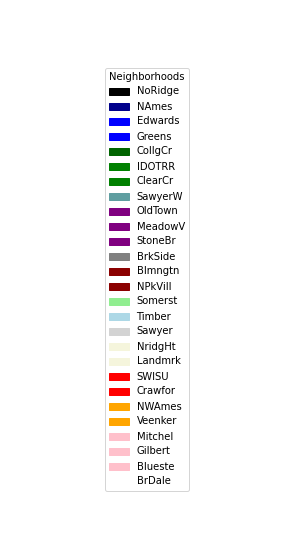

In [26]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

sorted_color_dict = dict(sorted(color_dict.items(), key=lambda item: item[1])) # Example sorting by color value


# Create patches for legend
patches = [mpatches.Patch(color=color, label=neighborhood) for neighborhood, color in sorted_color_dict.items()]

# Plot
plt.figure(figsize=(5,10))
plt.legend(handles=patches, loc='center', title='Neighborhoods')
plt.axis('off')

plt.show()

In [27]:
# Plot houses in terms of price per area
from branca.colormap import linear
from branca.colormap import LinearColormap
import matplotlib.colors as mcolors


ames_maps['PricePerArea'] = ames_maps['SalePrice'] / ames_maps['GrLivArea']

# Custom colors
colors = ["#808080", "#A52A2A", "#FF0000", "#FFA500", "#FFC0CB"]
cmap = LinearColormap(colors, vmin=ames_maps['PricePerArea'].min(), vmax=ames_maps['PricePerArea'].max())
map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['PricePerArea']),
        fill=True,
        fill_color=cmap(row['PricePerArea'])
    ).add_to(map)


# Add colormap legend
cmap.add_to(map)

map

In [28]:
# Plot houses colored by grlivarea

# Custom colors
colors = ["#808080", "#A52A2A", "#FF0000", "#FFA500", "#FFC0CB"]
cmap = LinearColormap(colors, vmin=ames_maps['GrLivArea'].min(), vmax=ames_maps['GrLivArea'].max())
map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['GrLivArea']),
        fill=True,
        fill_color=cmap(row['GrLivArea'])
    ).add_to(map)


# Add colormap legend
cmap.add_to(map)

map

In [29]:
# Plot houses colored by MSSubClass (home style)

ames_map = ames_maps.copy()

map = folium.Map(location= [ames_map['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

house_types = ames_maps['MSSubClass'].unique()
colors=['red', 'blue', 'green','purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
color_dict = {neighborhood: colors[i % len(colors)] for i, neighborhood in enumerate(house_types)}

for _,row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        color=color_dict[row['MSSubClass']],
        fill=True,
        fill_color=color_dict[row['MSSubClass']]
        ).add_to(map)

map

In [30]:
# Plot homes colored by OverallQual
import branca

# Custom colors
colors = ["#808080", "#A52A2A", "#FF0000", "#FFA500", "#FFC0CB"]
cmap = LinearColormap(colors, vmin=ames_maps['OverallQual'].min(), vmax=ames_maps['OverallQual'].max())
map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['OverallQual']),
        fill=True,
        fill_color=cmap(row['OverallQual'])
    ).add_to(map)


# Add colormap legend
cmap.add_to(map)

map

In [31]:
# Plot homes by enclosed porch size
# Custom colors
colors = ["#808080", "#A52A2A", "#FF0000", "#FFA500", "#FFC0CB"]
cmap = LinearColormap(colors, vmin=ames_maps['EnclosedPorch'].min(), vmax=ames_maps['EnclosedPorch'].max())
map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['EnclosedPorch']),
        fill=True,
        fill_color=cmap(row['EnclosedPorch'])
    ).add_to(map)


# Add colormap legend
cmap.add_to(map)

map

In [32]:
# Drop huge lots and plot homes on map colored by LotArea
lotdrop = ames_maps[ames_maps['LotArea'] > 100000].index
ames_maps_ld = ames_maps.drop(lotdrop)

# Custom colors
colors = ["#808080", "#4C0000", "#990000", "#E50000", "#FF1919", "#FF4C4C", "#FF7F7F", "#FFB2B2","#ffe5e5"]
cmap = LinearColormap(colors, vmin=ames_maps_ld['LotArea'].min(), vmax=ames_maps_ld['LotArea'].max())
map = folium.Map(location= [ames_maps_ld['Latitude'].mean(), ames_maps_ld['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['LotArea']),
        fill=True,
        fill_color=cmap(row['LotArea'])
    ).add_to(map)


# Add  colormap  legend
cmap.add_to(map)

map

In [33]:
# Map homes colored by External Quality
# Custom colors
colors = ["#808080", "#A52A2A", "#FF0000", "#FFA500", "#FFC0CB"]
cmap = LinearColormap(colors, vmin=ames_maps['ExterQual'].min(), vmax=ames_maps['ExterQual'].max())
map = folium.Map(location= [ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3, # size of the dot
        color=cmap(row['ExterQual']),
        fill=True,
        fill_color=cmap(row['ExterQual'])
    ).add_to(map)


# Add  colormap legend
cmap.add_to(map)

map

In [34]:
# Map homes by LotArea
colors = ['black', 'darkgrey', 'darkred', 'lightred', 'pink', 'blue', 'cadetblue', 'green', 'yellow', 'beige']

num_bins = len(colors)
bins = np.linspace(ames_maps['LotArea'].min(), ames_maps['LotArea'].max(), num_bins + 1)
ames_maps['Color'] = pd.cut(ames_maps['LotArea'], bins=bins, labels=colors, include_lowest=True)

# Initialize map
map = folium.Map(location=[ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # size of the dot
        color=row['Color'],
        fill=True,
        fill_color=row['Color']
    ).add_to(map)

# Display map
map


In [35]:
# Map homes by garage cars

ames_maps = ames_maps.copy()
ames_maps['GarageCars'] = pd.to_numeric(ames_maps['GarageCars'], errors='coerce')

# Define colors 
color_map = {1: 'blue', 2: 'green', 3: 'red'}

# Initialize map
map = folium.Map(location=[ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)


for _, row in ames_maps.iterrows():
    color = color_map.get(row['GarageCars'], 'gray')  
    
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  
        color=color,
        fill=True,
        fill_color=color
    ).add_to(map)

map


In [36]:
# Map homes colored by YearBuilt

ames_maps = ames_maps.copy()

colors = ['darkred', 'red', 'orange', 'green', 'blue', 'purple']

num_bins = len(colors)
bins = np.linspace(ames_maps['YearBuilt'].min(), ames_maps['YearBuilt'].max(), num_bins + 1)
ames_maps['Color'] = pd.cut(ames_maps['YearBuilt'], bins=bins, labels=colors, include_lowest=True)

map = folium.Map(location=[ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  
        color=row['Color'],
        fill=True,
        fill_color=row['Color']
    ).add_to(map)

map


In [37]:
# Map homes colored by overalll quality
ames_maps = ames_maps.copy()

colors = ['black','darkgrey','brown','blue', 'green', 'red', 'orange',  'yellow', 'beige']

num_bins = len(colors)
bins = np.linspace(ames_maps['OverallQual'].min(), ames_maps['OverallQual'].max(), num_bins + 1)
ames_maps['Color'] = pd.cut(ames_maps['OverallQual'], bins=bins, labels=colors, include_lowest=True)

map = folium.Map(location=[ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  
        color=row['Color'],
        fill=True,
        fill_color=row['Color']
    ).add_to(map)


map


In [38]:
# Create Distance from City Center feature

from math import radians, cos, sin, asin, sqrt

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate circle distance in km between two points 
    """
    # Convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = radians(lon1), radians(lat1), radians(lon2), radians(lat2)

    # Haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371  # Radius of earth in kilometers.
    return c * r

# Coordinates of  city center
city_center_lon = -93.6250
city_center_lat = 42.0308

# Calc distance from city center for each home
ames_maps['DistanceFromCenter'] = ames_maps.apply(
    lambda row: haversine(city_center_lon, city_center_lat, row['Longitude'], row['Latitude']),
    axis=1
)


In [39]:
# Create Kmeans for clustering into better clusters than neighborhoods
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

ames_maps = ames_maps.copy()

ames_maps = ames_maps.replace('None', np.nan)

ames_maps = ames_maps[['PID','DistanceFromCenter', 'GrLivArea', 'OverallQual', 'GarageCars', 'YearBuilt', 'Longitude', 'Latitude']]

ames_maps.dropna(inplace=True)

# Features for clustering
features = [ 'Longitude', 'Latitude', 'GrLivArea', 'OverallQual']
X = ames_maps[features]

# Standardize
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# K-means
kmeans = KMeans(n_clusters=100, random_state=42)
ames_maps['Cluster'] = kmeans.fit_predict(X_scaled)

# Colors
cmap = plt.cm.get_cmap('Spectral', 100)

# Map clusters
map_clusters = folium.Map(location=[ames_maps['Latitude'].mean(), ames_maps['Longitude'].mean()], zoom_start=12)

for _, row in ames_maps.iterrows():
    cluster_num = int(row['Cluster']) if pd.notna(row['Cluster']) else -1
    cluster_color_hex = matplotlib.colors.to_hex(cmap(cluster_num)) if cluster_num >= 0 else 'gray'

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        color=cluster_color_hex,
        fill=True,
        fill_color=cluster_color_hex
    ).add_to(map_clusters)

map_clusters